In [8]:
import numpy as np
import pandas as pd 
import os
import plotly.express as px
import matplotlib.pyplot as plt
import cv2
from wordcloud import WordCloud, STOPWORDS
import warnings

In [13]:
list_images = list()
for filename in os.listdir("images"):
    if filename.endswith(".jpg"):
        list_images.append(filename)

In [12]:
train = pd.read_csv('train.csv')
test = pd.read_csv('test.csv')

In [7]:
train['image_id'] = train['guid'] + '.jpg'

In [8]:
test['image_id'] = test['guid'] + '.jpg'

In [16]:
train['have_image'] = train['image_id'].apply(lambda x: 1 if x in list_images else 0)

In [18]:
ds = train['typology'].value_counts().reset_index()
ds.columns = ['typology', 'typologies_count']
ds['typology'] = ds['typology'].astype(str)
ds = ds.sort_values(['typologies_count'])

fig = px.bar(
    ds.tail(20), 
    x="typologies_count", 
    y="typology", 
    orientation='h', 
    title='Top 15 groups by number of products', 
    width=1000, 
    height=600
)

fig.show()

###### изображения

In [19]:
def plot_images(group):
    plot_list = train[(train['typology'] == group) & (train['have_image'] == 1)].head(9)
    plot_list = plot_list['image_id'].tolist()
    images_number = len(plot_list)
    size = np.sqrt(images_number)
    if int(size)*int(size) < images_number:
        size = int(size) + 100
    plt.figure(figsize=(20, 20))
    ind=0
    for image_id in plot_list:
        plt.subplot(size, size, ind + 1)
        image = cv2.imread(os.path.join('images/', image_id))
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        plt.imshow(image)
        plt.title(train.query(f"image_id=='{image_id}'")['description'].values[0][0:50], fontsize=10)
        plt.axis("off")
        ind+=1
    plt.show()

<ipython-input-19-5aad5264807b>:11: MatplotlibDeprecationWarning:

Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.



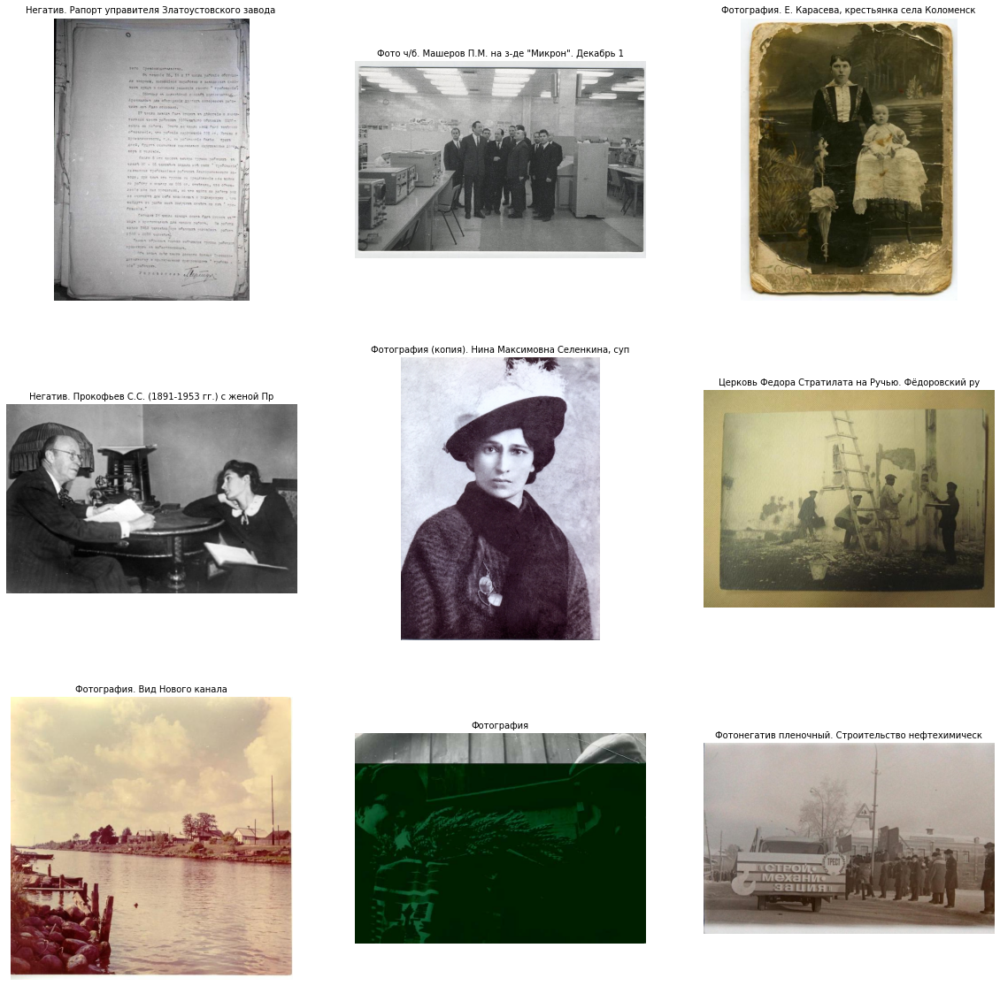

In [20]:
plot_images('фотографии и негативы')

<ipython-input-111-5aad5264807b>:11: MatplotlibDeprecationWarning:

Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.



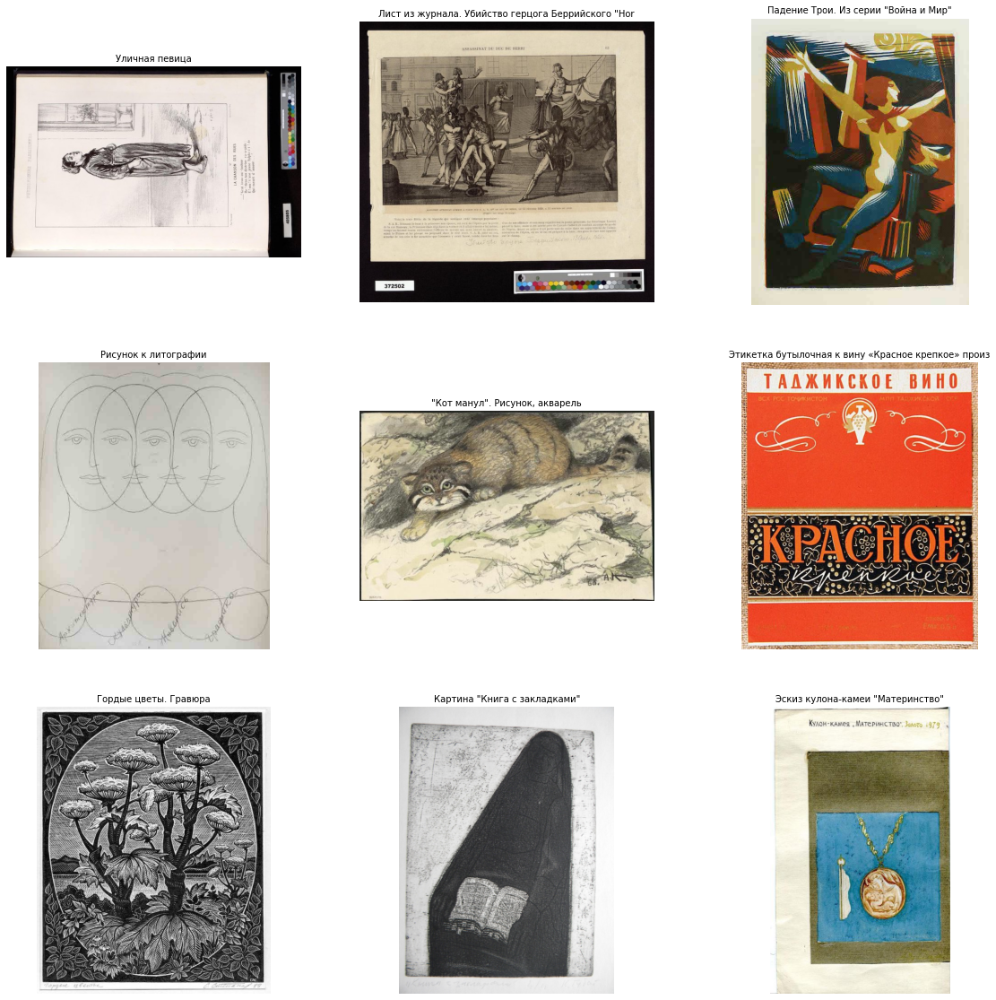

In [114]:
plot_images('графика')

<ipython-input-111-5aad5264807b>:11: MatplotlibDeprecationWarning:

Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.



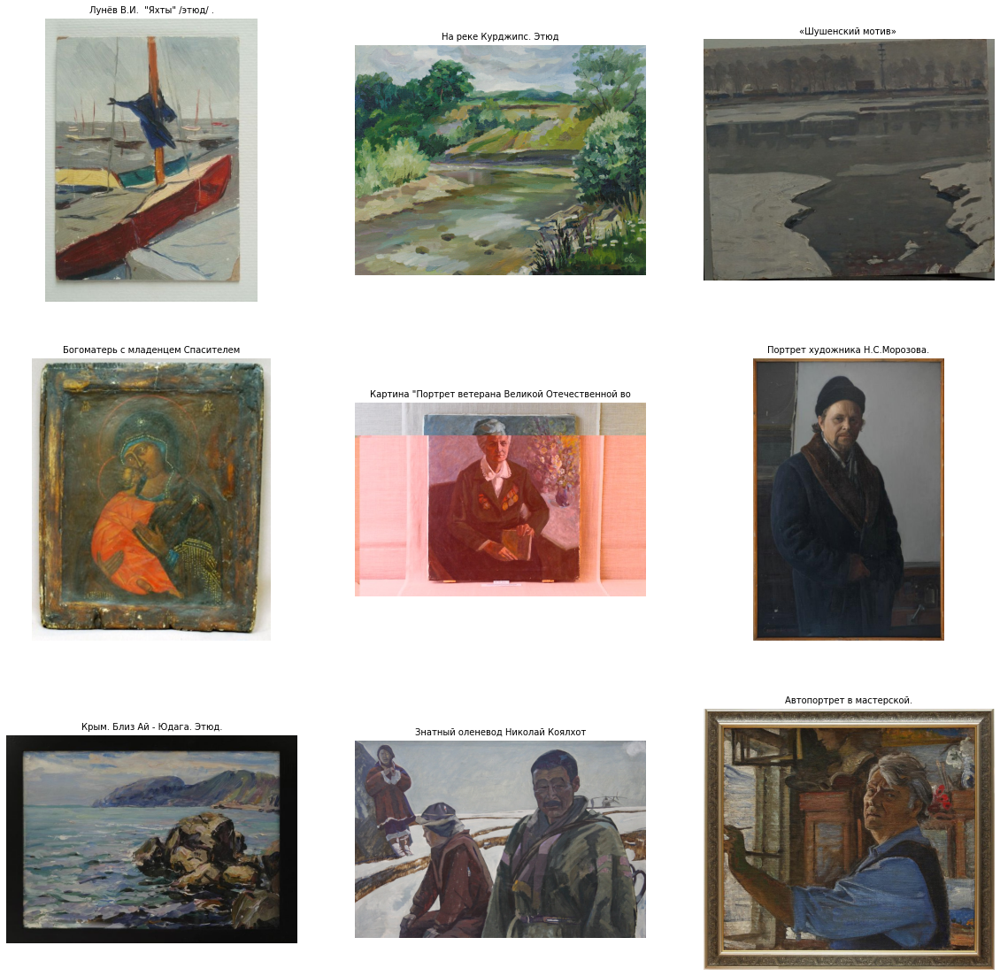

In [115]:
plot_images('живопись')

<ipython-input-111-5aad5264807b>:11: MatplotlibDeprecationWarning:

Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.



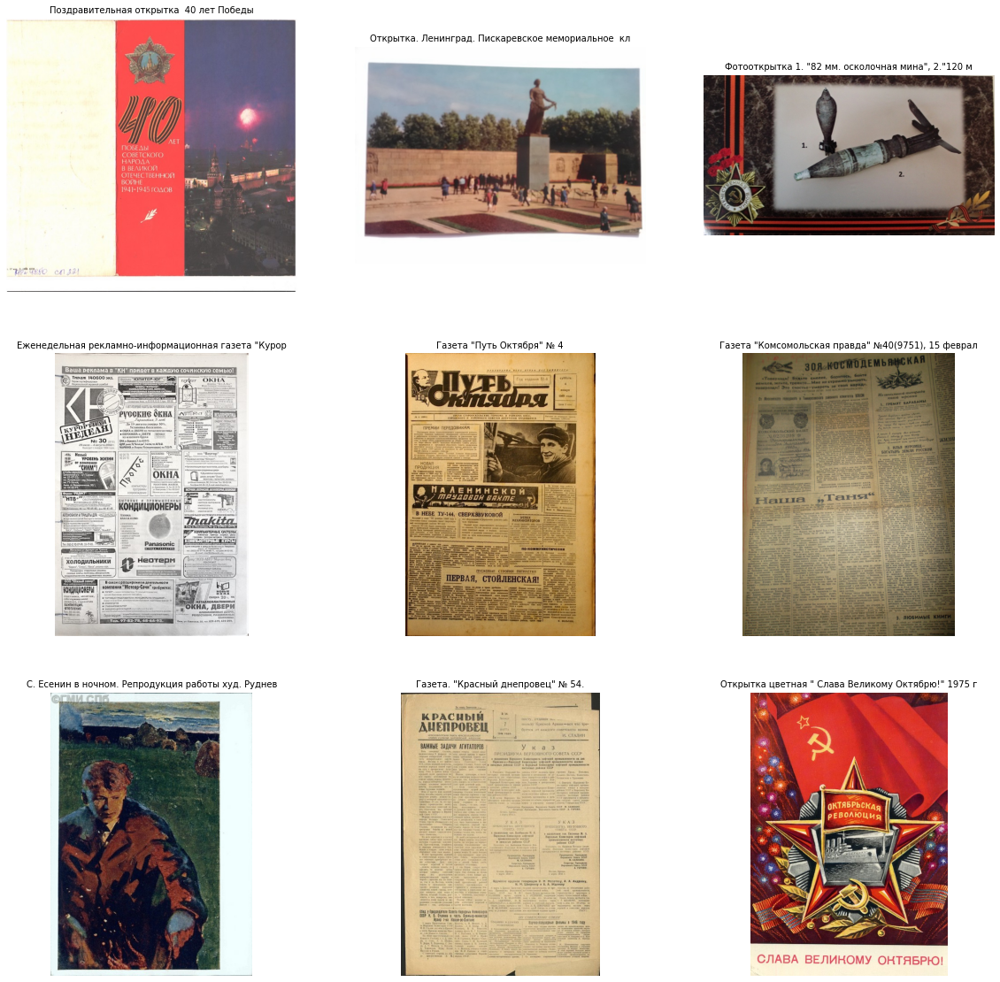

In [116]:
plot_images('предметы печатной продукции')

<ipython-input-111-5aad5264807b>:11: MatplotlibDeprecationWarning:

Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.



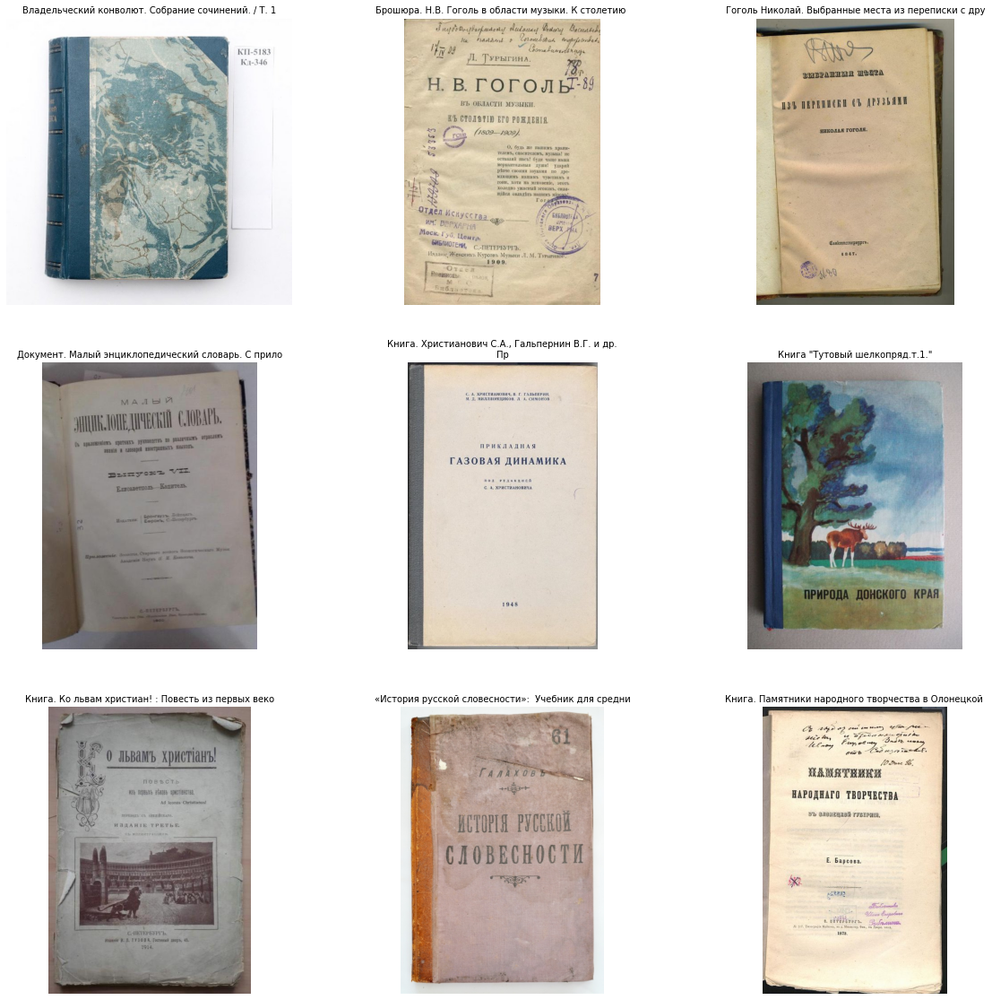

In [118]:
plot_images('редкие книги')

<ipython-input-68-8e3acf633b2d>:11: MatplotlibDeprecationWarning:

Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.



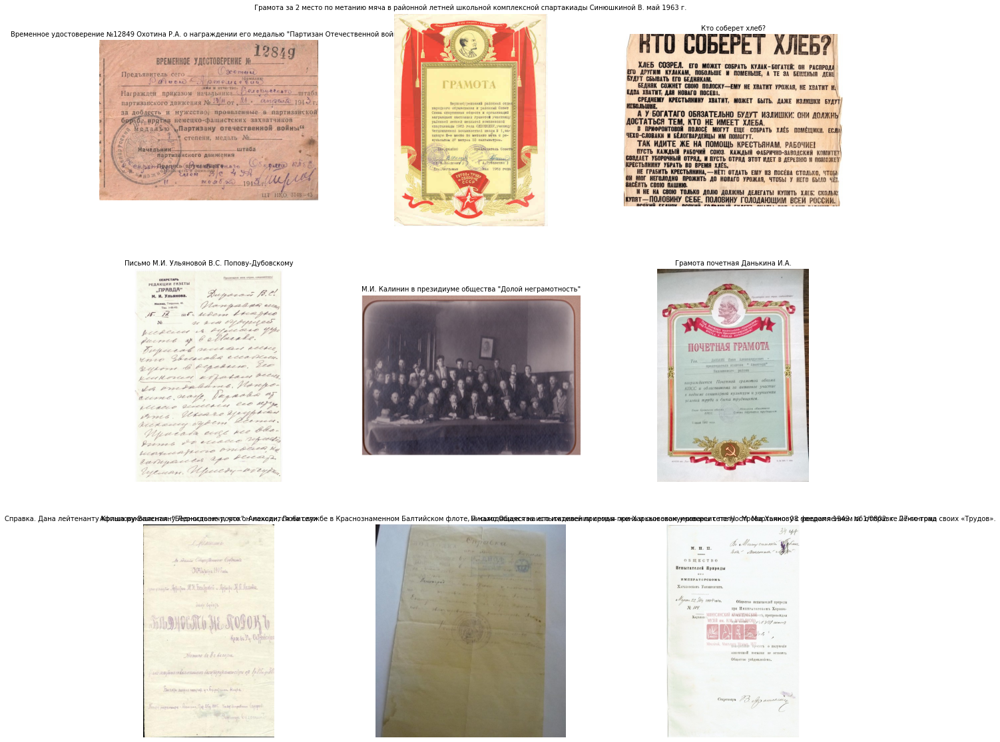

In [71]:
plot_images('документы')

<ipython-input-68-8e3acf633b2d>:11: MatplotlibDeprecationWarning:

Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.



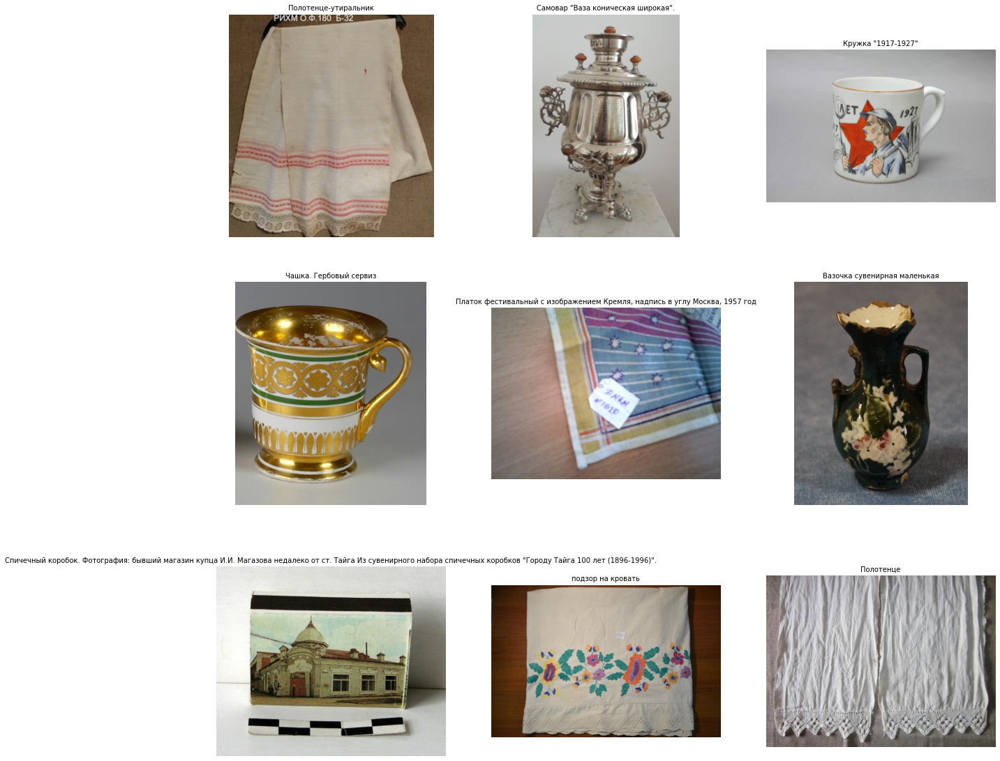

In [72]:
plot_images('предметы прикладного искусства, быта и этнографии')

<ipython-input-68-8e3acf633b2d>:11: MatplotlibDeprecationWarning:

Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.



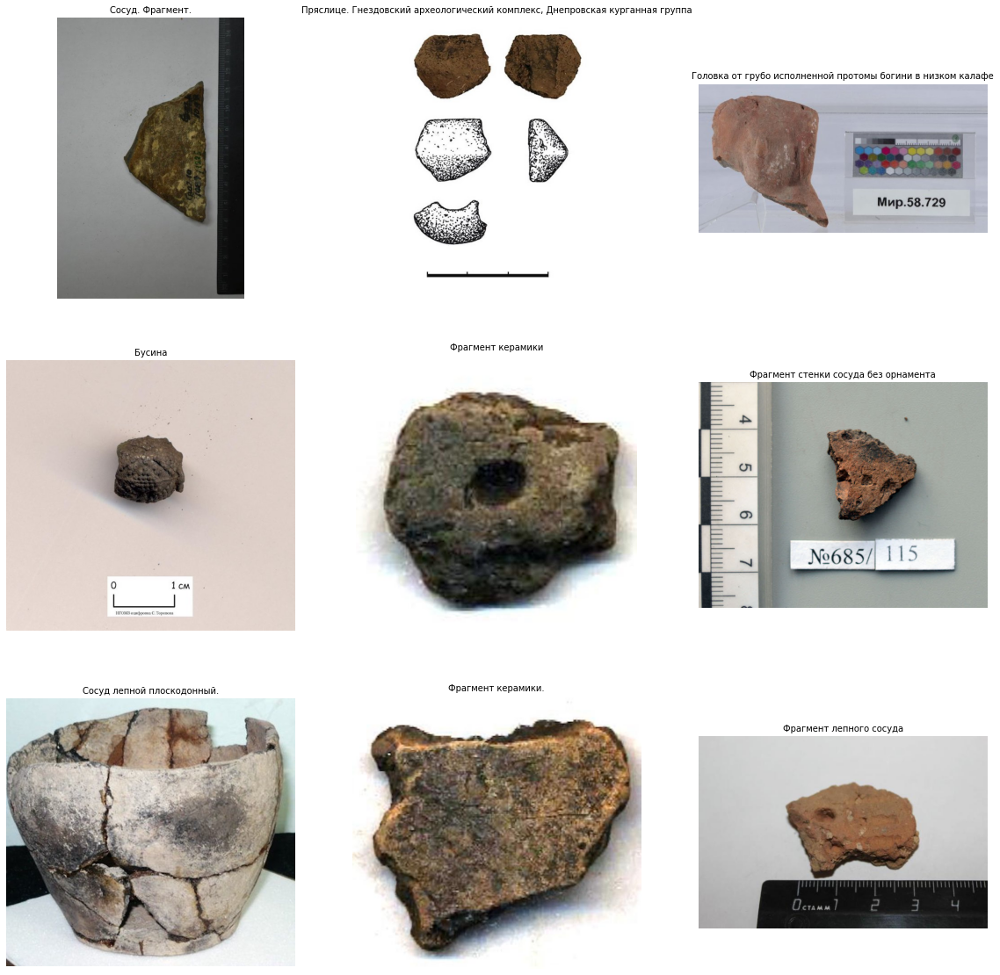

In [73]:
plot_images('предметы археологии')

<ipython-input-68-8e3acf633b2d>:11: MatplotlibDeprecationWarning:

Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.



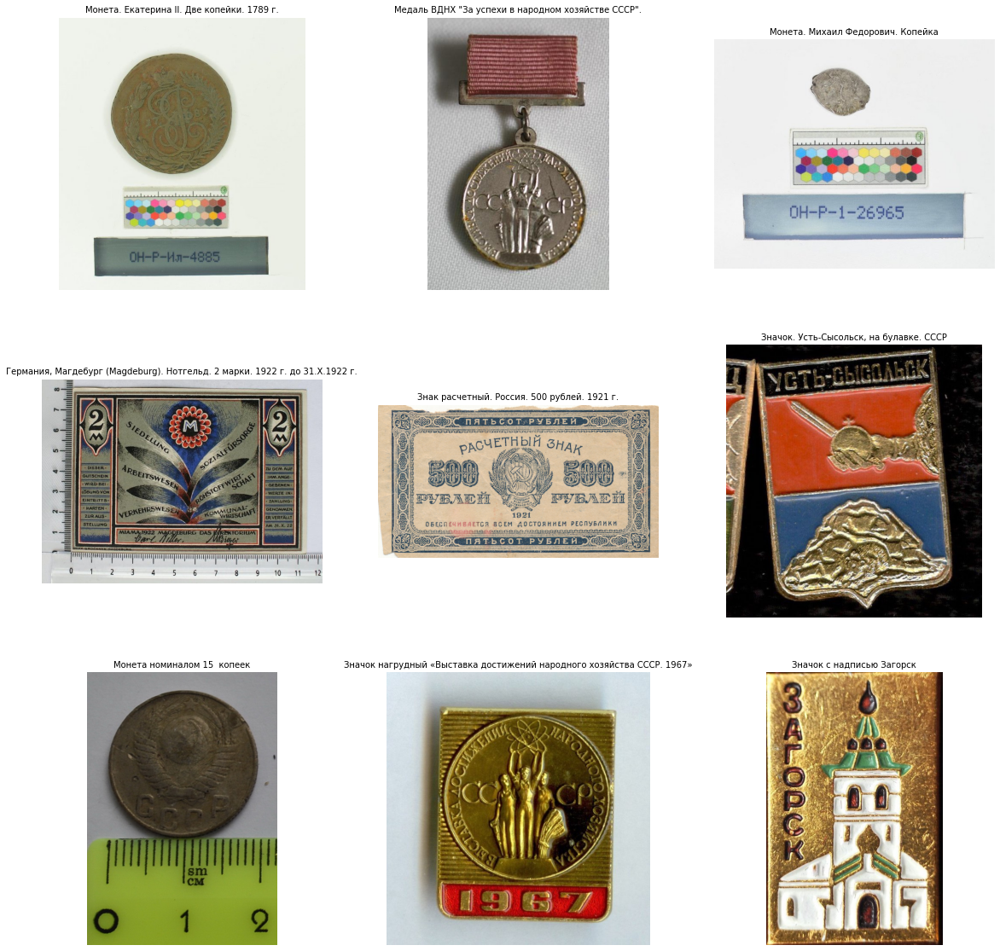

In [74]:
plot_images('предметы нумизматики')

<ipython-input-68-8e3acf633b2d>:11: MatplotlibDeprecationWarning:

Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.



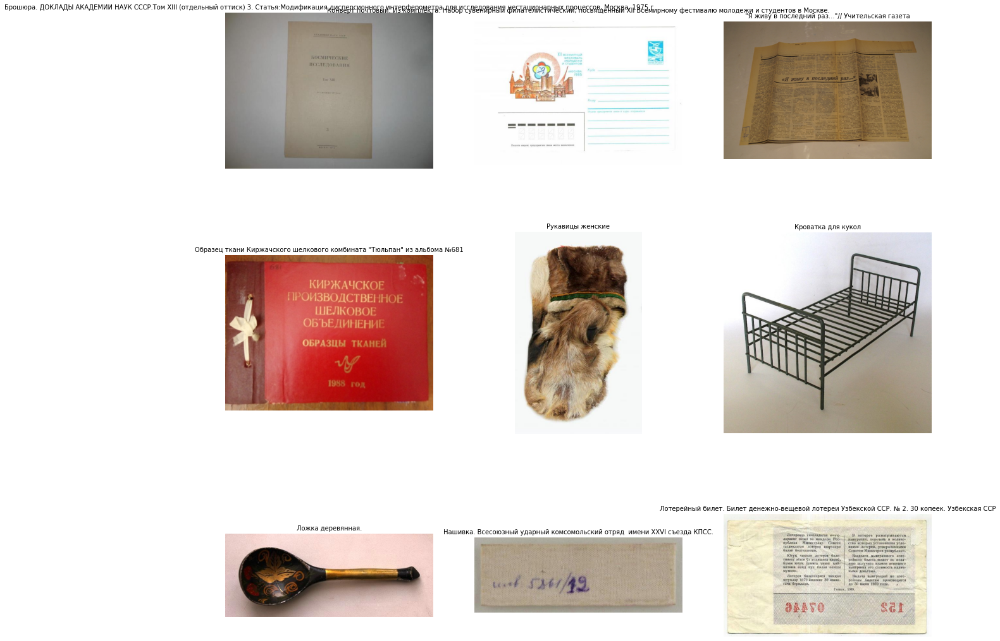

In [77]:
plot_images('прочие')

<ipython-input-79-5aad5264807b>:11: MatplotlibDeprecationWarning:

Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.



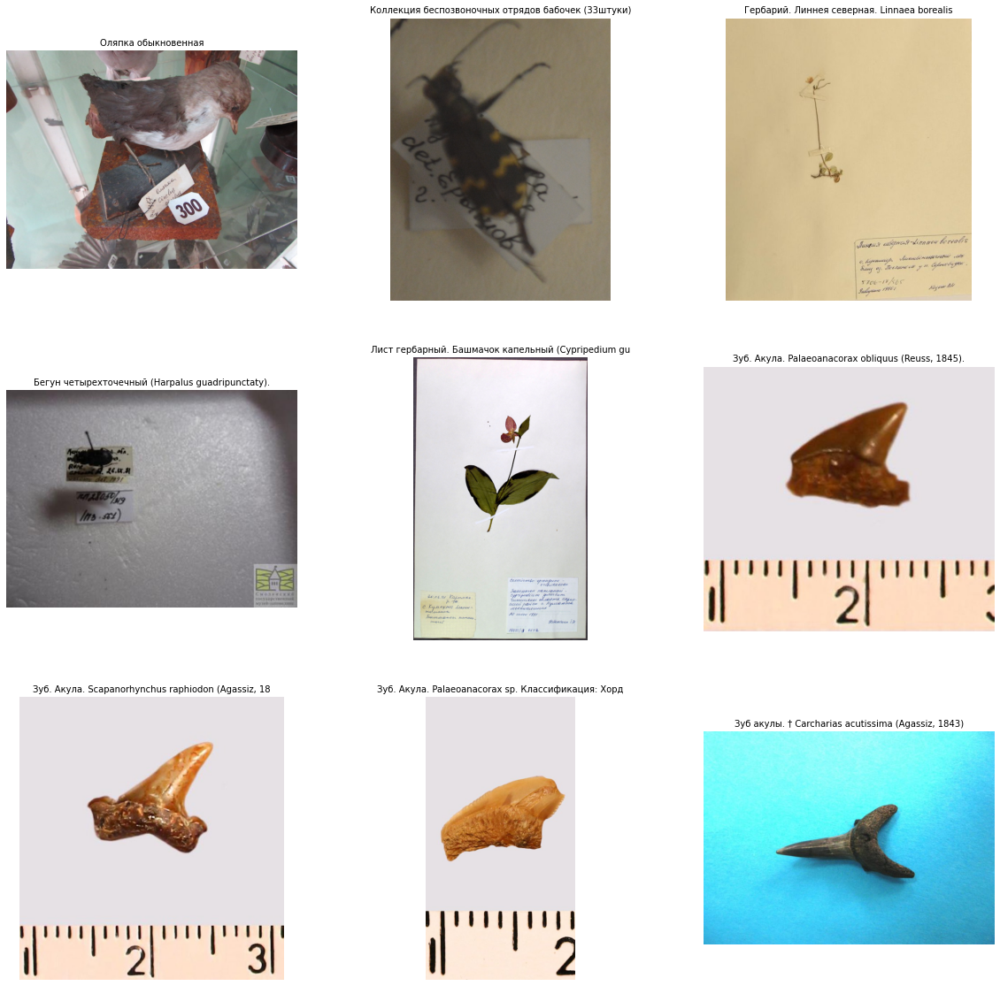

In [81]:
plot_images('предметы естественнонаучной коллекции')

<ipython-input-79-5aad5264807b>:11: MatplotlibDeprecationWarning:

Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.



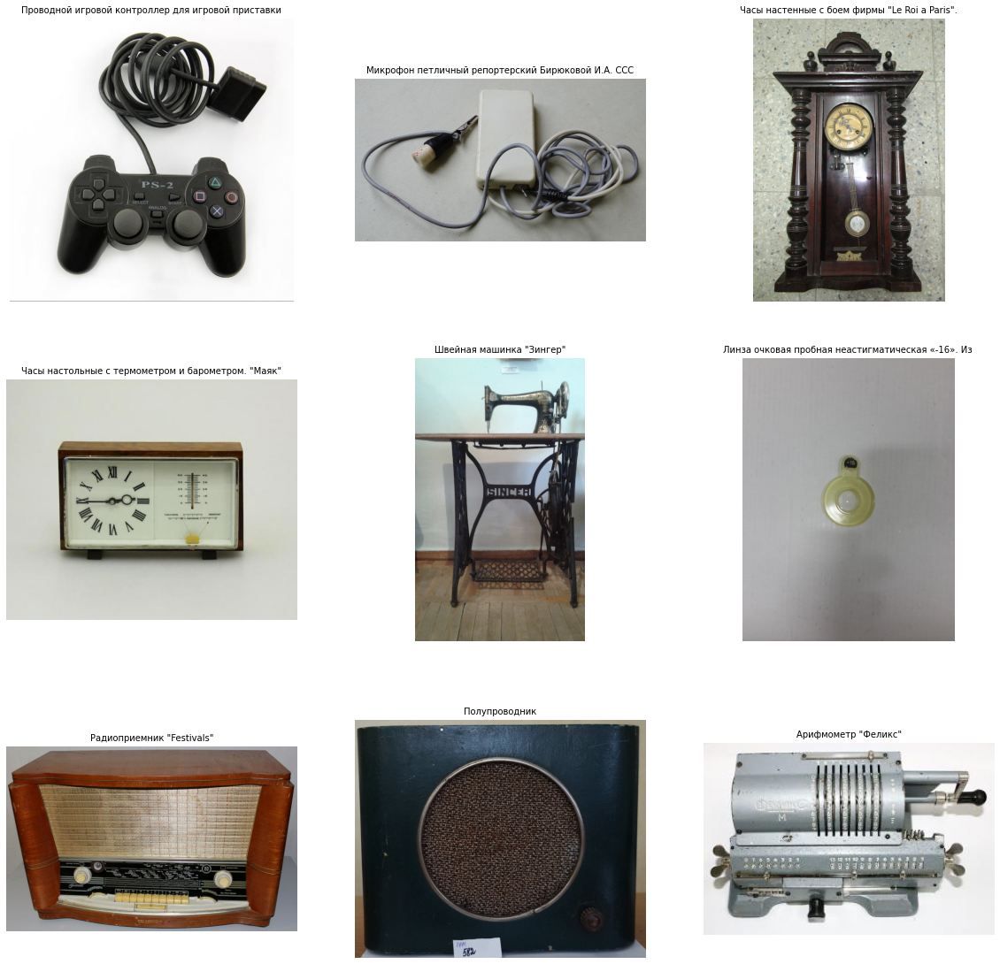

In [83]:
plot_images('предметы техники')

<ipython-input-79-5aad5264807b>:11: MatplotlibDeprecationWarning:

Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.



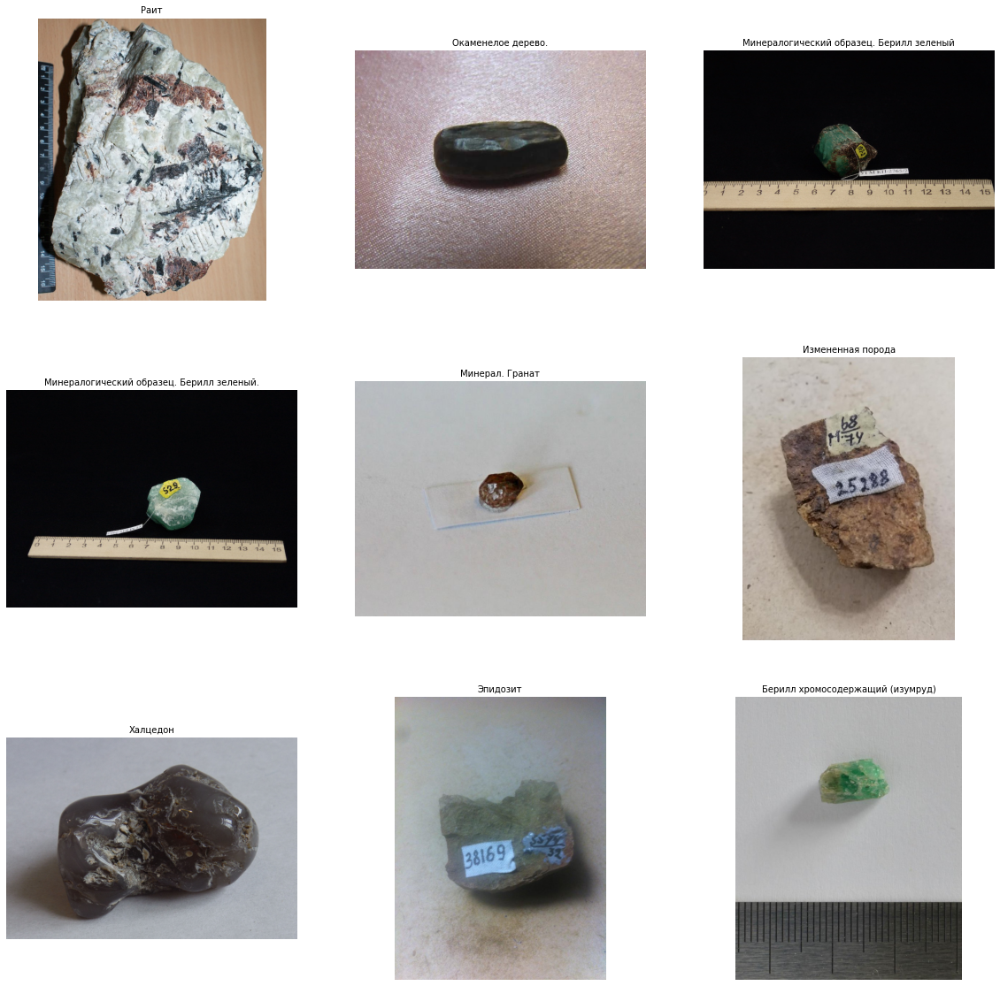

In [86]:
plot_images('предметы минералогической коллекции')

<ipython-input-79-5aad5264807b>:11: MatplotlibDeprecationWarning:

Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.



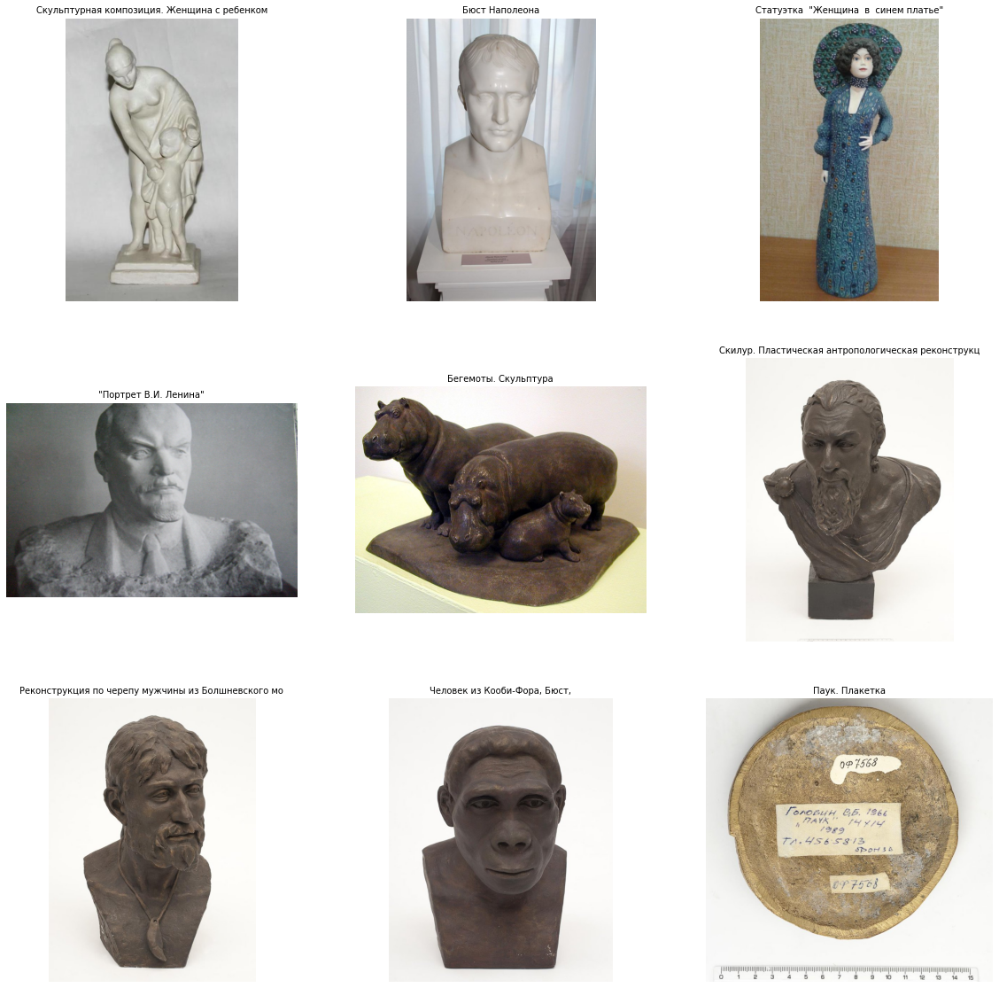

In [87]:
plot_images('скульптура')

<ipython-input-79-5aad5264807b>:11: MatplotlibDeprecationWarning:

Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.



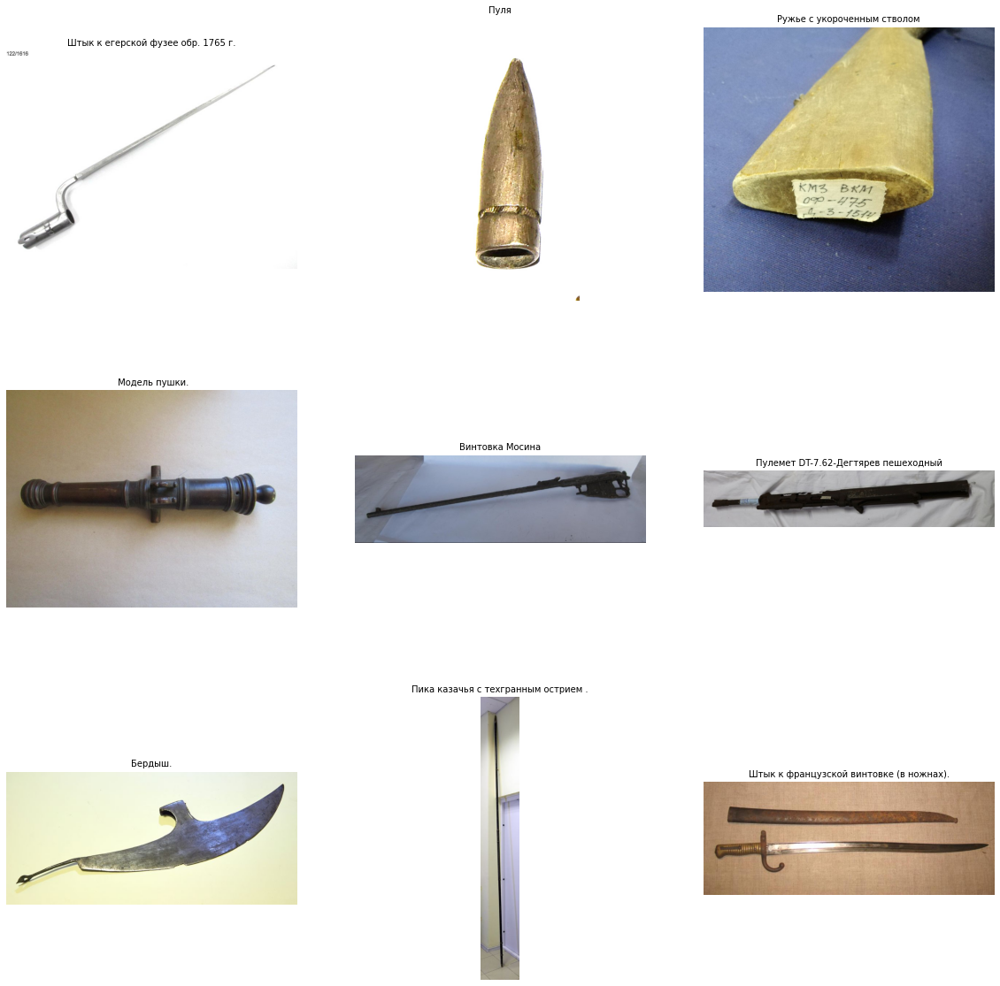

In [88]:
plot_images('оружие')

##### текст

In [28]:
from pymystem3 import Mystem
import nltk 
import string
from nltk.corpus import stopwords
from collections import Counter
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /home/eugene/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [21]:
russian_stopwords = stopwords.words("russian")
mystem = Mystem() 

In [22]:
#удаление пунктуации
def RemovePunctuation(text):
    if str(text)!='nan':
        text = text.lower()
        translator = str.maketrans('', '', string.punctuation)
        return text.translate(translator)
    else:
        return text

In [23]:
#к основе слова, удаление цифр, стоп-слов 
def Initial_form(text):
    text = str(text)
    tokens = mystem.lemmatize(text.lower())
    tokens = [token for token in tokens if token not in russian_stopwords\
              and token != " " \
              and len(token)>=3 \
              and token.isdigit()==False]
    text = " ".join(tokens)
    return text

In [24]:
train['description2'] = train['description'].apply(lambda x: RemovePunctuation(x)) 
train['description2'] = train['description2'].apply(lambda x: Initial_form(x)) 

Сформирую словарь топ слов (2-5 слов) для каждой категории (если слова пересекаются между категориями - беру следующее слово по порядку топов). Далее если эти слова будут встречаться в других категориях, то удалять эти экземпляры из обучающей выборки.

In [26]:
#функция для расчет топ слов в определнной категории
def define_top_words(text, show_number_top=10):
    corpus = ''
    for i in text:
        corpus = corpus + ' ' + i
    Count = Counter(corpus.split())
    return Count.most_common(show_number_top)

In [29]:
define_top_words(train.query("typology=='документы'")['description2'].tolist(), 20)

[('театр', 119),
 ('письмо', 108),
 ('документ', 74),
 ('москва', 55),
 ('удостоверение', 48),
 ('грамота', 48),
 ('фотография', 47),
 ('программа', 47),
 ('афиша', 40),
 ('государственный', 39),
 ('год', 35),
 ('роль', 35),
 ('почетный', 34),
 ('имя', 31),
 ('совет', 29),
 ('газета', 28),
 ('драматический', 28),
 ('негатив', 24),
 ('день', 24),
 ('московский', 23)]

In [30]:
define_top_words(train.query("typology=='фотографии и негативы'")['description2'].tolist(), 20)

[('фотография', 371),
 ('негатив', 97),
 ('фото', 86),
 ('чернобелый', 44),
 ('вид', 43),
 ('год', 38),
 ('дом', 37),
 ('портрет', 30),
 ('участник', 29),
 ('театр', 28),
 ('район', 24),
 ('роль', 24),
 ('великий', 23),
 ('война', 23),
 ('фотонегатив', 21),
 ('церковь', 20),
 ('сюжетный', 19),
 ('групповой', 19),
 ('улица', 19),
 ('советский', 18)]

In [31]:
define_top_words(train.query("typology=='предметы археологии'")['description2'].tolist(), 20)

[('фрагмент', 274),
 ('сосуд', 194),
 ('стенка', 97),
 ('раскопка', 72),
 ('коллекция', 62),
 ('керамика', 43),
 ('лепной', 42),
 ('материал', 41),
 ('венчик', 41),
 ('стоянка', 39),
 ('отщеп', 38),
 ('керамический', 29),
 ('елин', 28),
 ('бор', 28),
 ('пластина', 27),
 ('гончарный', 18),
 ('памятник', 17),
 ('бус', 17),
 ('цвет', 17),
 ('археологический', 16)]

In [32]:
define_top_words(train.query("typology=='предметы прикладного искусства, быта и этнографии'")['description2'].tolist(), 20)

[('образец', 57),
 ('ткань', 46),
 ('альбом', 33),
 ('игрушка', 18),
 ('женский', 18),
 ('узор', 17),
 ('русский', 16),
 ('чашка', 15),
 ('комплект', 14),
 ('блюдце', 14),
 ('шелковый', 14),
 ('сервиз', 12),
 ('набор', 12),
 ('цвет', 12),
 ('предмет', 11),
 ('фрагмент', 11),
 ('крышка', 11),
 ('тарелка', 10),
 ('тканый', 10),
 ('ситец', 10)]

In [33]:
define_top_words(train.query("typology=='предметы нумизматики'")['description2'].tolist(), 20)

[('монета', 269),
 ('копейка', 194),
 ('значок', 79),
 ('знак', 66),
 ('рубль', 61),
 ('год', 50),
 ('ссср', 41),
 ('россия', 40),
 ('государственный', 40),
 ('билет', 38),
 ('денежный', 37),
 ('медаль', 36),
 ('империя', 35),
 ('марка', 33),
 ('российский', 29),
 ('почтовый', 28),
 ('кредитный', 24),
 ('время', 23),
 ('достоинство', 20),
 ('военный', 20)]

In [34]:
define_top_words(train.query("typology=='предметы печатной продукции'")['description2'].tolist(), 20)

[('газета', 106),
 ('открытка', 76),
 ('книга', 64),
 ('год', 54),
 ('почтовый', 51),
 ('москва', 36),
 ('марка', 33),
 ('советский', 33),
 ('журнал', 25),
 ('правда', 24),
 ('этикетка', 24),
 ('ссср', 24),
 ('октябрь', 19),
 ('совет', 19),
 ('государственный', 19),
 ('театр', 18),
 ('комплект', 18),
 ('нота', 18),
 ('копейка', 18),
 ('программа', 18)]

In [35]:
define_top_words(train.query("typology=='графика'")['description2'].tolist(), 20)

[('эскиз', 40),
 ('лист', 36),
 ('рисунок', 35),
 ('портрет', 30),
 ('гравюра', 27),
 ('почтовый', 21),
 ('серия', 19),
 ('альбом', 19),
 ('костюм', 18),
 ('иллюстрация', 17),
 ('москва', 16),
 ('экслибрис', 15),
 ('художественный', 15),
 ('год', 14),
 ('фильм', 13),
 ('плакат', 13),
 ('графический', 11),
 ('карточка', 11),
 ('марка', 10),
 ('проект', 10)]

In [36]:
define_top_words(train.query("typology=='живопись'")['description2'].tolist(), 20)

[('картина', 29),
 ('портрет', 11),
 ('этюд', 6),
 ('икона', 4),
 ('фреска', 4),
 ('фрагмент', 4),
 ('река', 2),
 ('великий', 2),
 ('война', 2),
 ('осень', 2),
 ('эскиз', 2),
 ('разлив', 2),
 ('натурщица', 2),
 ('святой', 2),
 ('митрополит', 2),
 ('суханова', 2),
 ('год', 2),
 ('лунев', 1),
 ('яхта', 1),
 ('курджипс', 1)]

In [37]:
define_top_words(train.query("typology=='редкие книги'")['description2'].tolist(), 20)

[('книга', 106),
 ('журнал', 28),
 ('год', 26),
 ('спб', 23),
 ('тип', 20),
 ('издание', 19),
 ('русский', 18),
 ('газета', 13),
 ('ссср', 12),
 ('–', 11),
 ('конволют', 10),
 ('типография', 10),
 ('брошюра', 8),
 ('труд', 8),
 ('москва', 8),
 ('табла', 8),
 ('сочинение', 7),
 ('российский', 7),
 ('печать', 7),
 ('собрание', 6)]

In [38]:
define_top_words(train.query("typology=='предметы естественнонаучной коллекции'")['description2'].tolist(), 20)

[('образец', 18),
 ('гербарный', 10),
 ('янтарь', 10),
 ('включение', 10),
 ('лист', 9),
 ('зуб', 9),
 ('бабочка', 8),
 ('обыкновенный', 6),
 ('гербарий', 6),
 ('акула', 6),
 ('фрагмент', 6),
 ('чучело', 6),
 ('жесткокрылый', 6),
 ('коллекция', 5),
 ('палеонтологический', 5),
 ('натура', 5),
 ('жуков', 4),
 ('классификация', 4),
 ('elasmobranchii', 4),
 ('яйцо', 4)]

In [39]:
define_top_words(train.query("typology=='скульптура'")['description2'].tolist(), 20)

[('бюст', 5),
 ('портрет', 5),
 ('скульптура', 4),
 ('женщина', 3),
 ('статуэтка', 3),
 ('реконструкция', 3),
 ('скульптурный', 2),
 ('пластический', 2),
 ('антропологический', 2),
 ('композиция', 1),
 ('ребенок', 1),
 ('наполеон', 1),
 ('синий', 1),
 ('платье', 1),
 ('ленин', 1),
 ('бегемот', 1),
 ('скилур', 1),
 ('череп', 1),
 ('мужчина', 1),
 ('болшневский', 1)]

In [40]:
define_top_words(train.query("typology=='оружие'")['description2'].tolist(), 20)

[('обр', 5),
 ('патрон', 4),
 ('винтовочный', 4),
 ('штык', 2),
 ('пуля', 2),
 ('винтовка', 2),
 ('762х53r', 2),
 ('асра', 2),
 ('пистолетный', 2),
 ('егерский', 1),
 ('фузея', 1),
 ('штуцер', 1),
 ('магазинный', 1),
 ('система', 1),
 ('манлихера', 1),
 ('наименование', 1),
 ('технический', 1),
 ('osterreichisches', 1),
 ('repetierstutzen', 1),
 ('m95', 1)]